In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/car_data/names.csv
/kaggle/input/car_data/anno_test.csv
/kaggle/input/car_data/anno_train.csv
/kaggle/input/car_data/car_data/names.csv
/kaggle/input/car_data/car_data/anno_test.csv
/kaggle/input/car_data/car_data/anno_train.csv
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/04772.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/08033.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/03004.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/06551.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/01397.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/06801.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/00641.jpg
/kaggle/input/car_data/car_data/car_data/test/Dodge Ram Pickup 3500 Crew Cab 2010/00455.jpg
/kaggle/input/car_dat

## import libraries

In [29]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.applications import Xception, DenseNet121
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input
from keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, auc,confusion_matrix, ConfusionMatrixDisplay

## load the data 

In [2]:
train_dir = "/kaggle/input/car_data/car_data/car_data/train/" 
test_dir = "/kaggle/input/car_data/car_data/car_data/test/"   

train_classes = os.listdir(train_dir)
test_classes = os.listdir(test_dir)

print("Classes in Train:", train_classes)
print("Classes in Test:", test_classes)

extra_classes = set(train_classes) - set(test_classes)
print("Extra classes in Train:", extra_classes)


Classes in Train: ['Dodge Ram Pickup 3500 Crew Cab 2010', 'Cadillac CTS-V Sedan 2012', 'Audi S5 Convertible 2012', 'Ram C-V Cargo Van Minivan 2012', 'smart fortwo Convertible 2012', 'Audi V8 Sedan 1994', 'Suzuki Kizashi Sedan 2012', 'Chevrolet Express Van 2007', 'Chrysler Town and Country Minivan 2012', 'Rolls-Royce Phantom Sedan 2012', 'Buick Regal GS 2012', 'Aston Martin V8 Vantage Convertible 2012', 'Rolls-Royce Phantom Drophead Coupe Convertible 2012', 'Audi TT Hatchback 2011', 'Chevrolet Malibu Hybrid Sedan 2010', 'Honda Odyssey Minivan 2012', 'BMW X6 SUV 2012', 'Audi 100 Wagon 1994', 'Volvo 240 Sedan 1993', 'Plymouth Neon Coupe 1999', 'Ford Focus Sedan 2007', 'Ford GT Coupe 2006', 'McLaren MP4-12C Coupe 2012', 'Dodge Caliber Wagon 2012', 'Acura TSX Sedan 2012', 'Chrysler 300 SRT-8 2010', 'Jeep Wrangler SUV 2012', 'Chevrolet Monte Carlo Coupe 2007', 'Chevrolet HHR SS 2010', 'Dodge Dakota Crew Cab 2010', 'Jeep Compass SUV 2012', 'Hyundai Veracruz SUV 2012', 'Buick Verano Sedan 2012

In [5]:
import shutil
import os

writable_dir = "/kaggle/working/train"

shutil.copytree("/kaggle/input/car_data/car_data/car_data/train/", writable_dir)

print("Data copied to writable directory.")


Data copied to writable directory.


## Data preprocessing

In [6]:
class_to_remove = "models"
class_path = os.path.join(writable_dir, class_to_remove)

if os.path.exists(class_path):
    shutil.rmtree(class_path)
    print(f"Class '{class_to_remove}' has been removed.")
else:
    print(f"Class '{class_to_remove}' not found.")


Class 'models' has been removed.


In [10]:
train_dir = '/kaggle/working/train/'  
     
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,  
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    brightness_range=[0.8, 1.2],
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 27671 images belonging to 196 classes.
Found 6846 images belonging to 196 classes.
Found 8041 images belonging to 196 classes.


## Xception Model

In [11]:
Xception_base_model = Xception(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

# Fine-tuning: Freeze all layers except the last 20
for layer in Xception_base_model.layers[:-20]:
    layer.trainable = False

num_classes = 196  # Number of classes 

# Add custom layers
x = Xception_base_model.output
x = GlobalAveragePooling2D()(x)  # Global pooling layer تقليل أبعاد البيانات استخدام  (average pooling)//تجنب الاوفرفيتنج .
x = Dense(1024, activation="relu")(x)  # Fully connected layer تضيف قدرة النموذج على تعلم الميزات المركبة.
x = Dropout(0.5)(x)  # Dropout for regularization تضمن نموذجًا متوازنًا.
x = Dense(512, activation="relu")(x)  # Another fully connected layer لتعلم ميزات أكثر تعقيدًا.
x = Dropout(0.5)(x)# Dropout for regularization
predictions = Dense(num_classes, activation="softmax")(x)  # Output layer تضمن أن مجموع القيم يساوي 1

# Create final model
Xception_model = Model(inputs=Xception_base_model.input, outputs=predictions)

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [12]:
# Compile the model
Xception_model.compile(
    optimizer=Adam(learning_rate=1e-4),  # Fine-tuning requires a lower learning rate
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

In [13]:
# Callbacks for training
reduce_lr = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.2,
    patience=3,
    min_lr=1e-6,
    verbose=1
)

early_stopping = EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True,
    verbose=1
)

callbacks = [reduce_lr, early_stopping]

## Train Xception Model

In [14]:
history = Xception_model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=15,  # Try increasing the number of epochs for better performance
    callbacks=callbacks,
    verbose=1
)

Epoch 1/15


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1734202983.138404     229 service.cc:145] XLA service 0x7ac954003d60 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734202983.138470     229 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1734202983.138474     229 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1734203001.343789     229 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


865/865 ━━━━━━━━━━━━━━━━━━━━ 503s 550ms/step - accuracy: 0.0113 - loss: 5.2218 - val_accuracy: 0.0796 - val_loss: 4.3885 - learning_rate: 1.0000e-04
Epoch 2/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 444s 510ms/step - accuracy: 0.0862 - loss: 4.2252 - val_accuracy: 0.2556 - val_loss: 3.0480 - learning_rate: 1.0000e-04
Epoch 3/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 445s 511ms/step - accuracy: 0.2185 - loss: 3.2098 - val_accuracy: 0.3989 - val_loss: 2.3398 - learning_rate: 1.0000e-04
Epoch 4/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 445s 511ms/step - accuracy: 0.3525 - loss: 2.5233 - val_accuracy: 0.4858 - val_loss: 1.9521 - learning_rate: 1.0000e-04
Epoch 5/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 445s 511ms/step - accuracy: 0.4609 - loss: 2.0157 - val_accuracy: 0.5406 - val_loss: 1.6812 - learning_rate: 1.0000e-04
Epoch 6/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 440s 506ms/step - accuracy: 0.5382 - loss: 1.6857 - val_accuracy: 0.5821 - val_loss: 1.5175 - learning_rate: 1.0000e-04
Epoch 7/15
865/865 ━━━━━━━━━━━━━━━━━━━━ 444s 510ms/

In [15]:

test_loss, test_accuracy = Xception_model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy}')

252/252 ━━━━━━━━━━━━━━━━━━━━ 74s 292ms/step - accuracy: 0.6971 - loss: 1.0925
Test Accuracy: 0.7364755868911743


## visualization for acc & loss for xception 

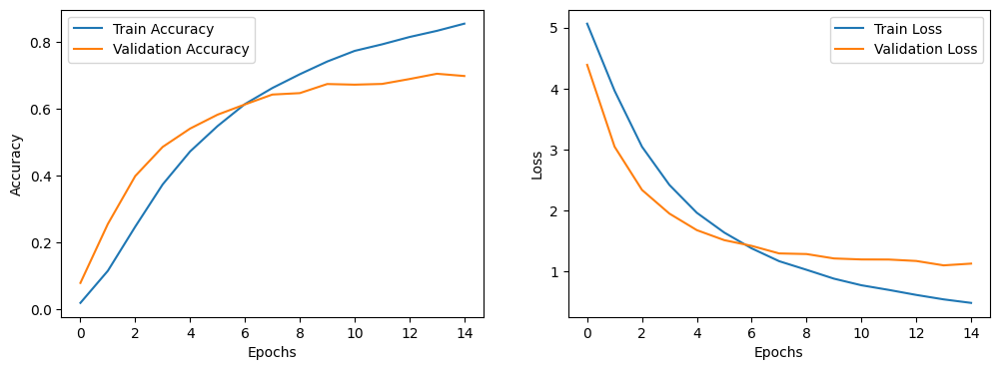

In [16]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label="Train Accuracy")
plt.plot(history.history['val_accuracy'], label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label="Train Loss")
plt.plot(history.history['val_loss'], label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()

plt.show()


## Confusion Matrix --> Xception

In [17]:
predictions = Xception_model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)


252/252 ━━━━━━━━━━━━━━━━━━━━ 42s 158ms/step


In [19]:
y_true_classes = test_generator.classes
# Compute confusion matrix
cm = confusion_matrix(y_true_classes, y_pred)
class_labels = list(test_generator.class_indices.keys())  # Class names

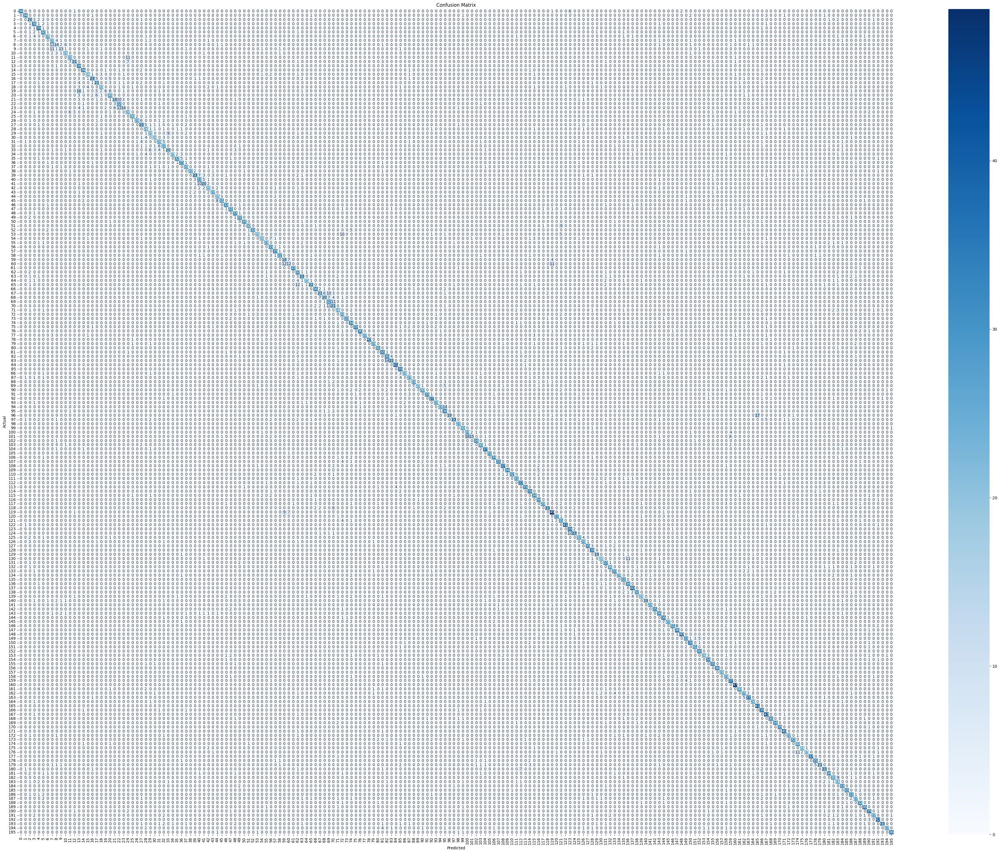

In [18]:
cm = confusion_matrix(test_generator.classes, y_pred)
plt.figure(figsize=(50, 38))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()


## confusion matrix for classes

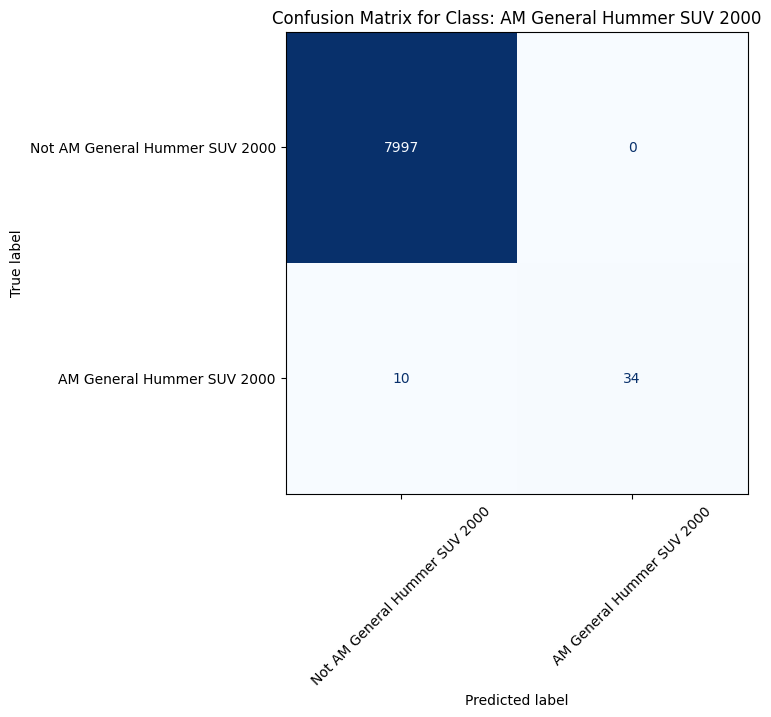

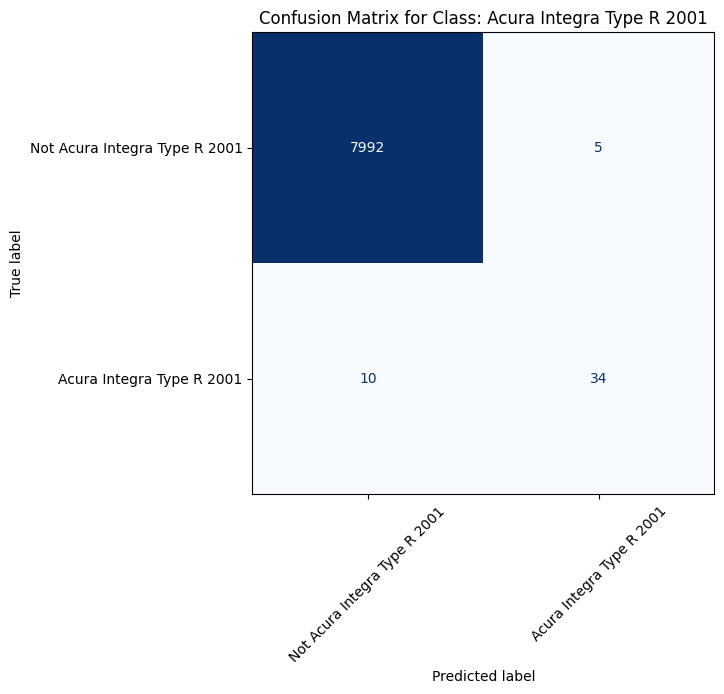

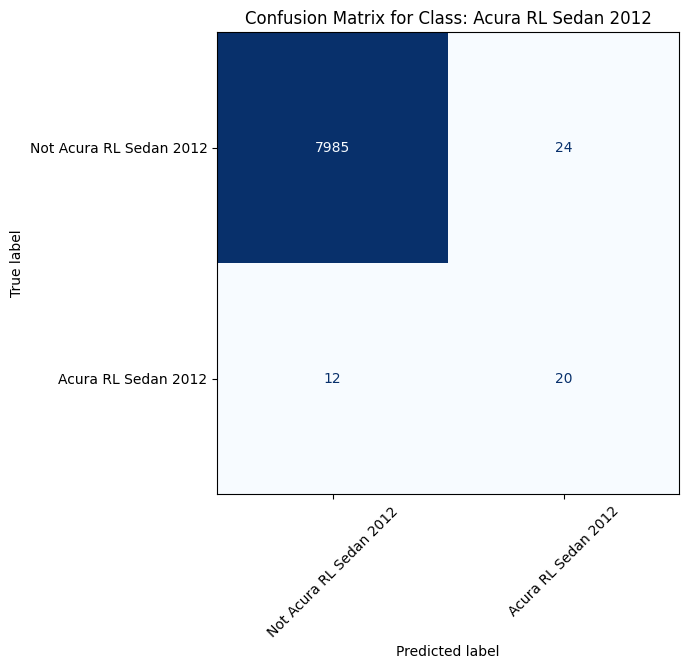

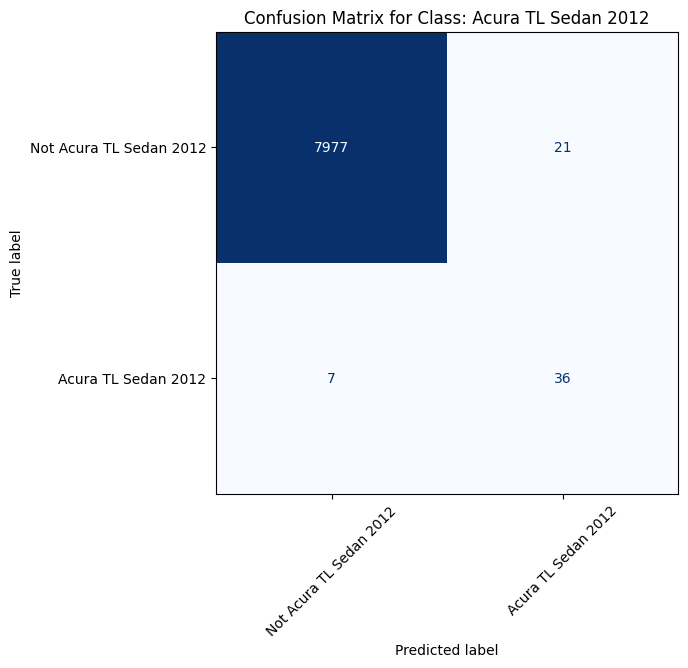

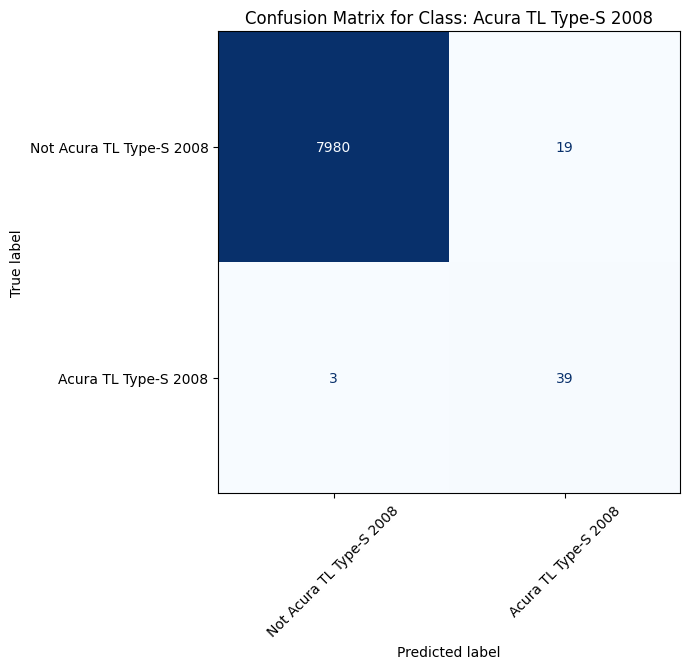

...

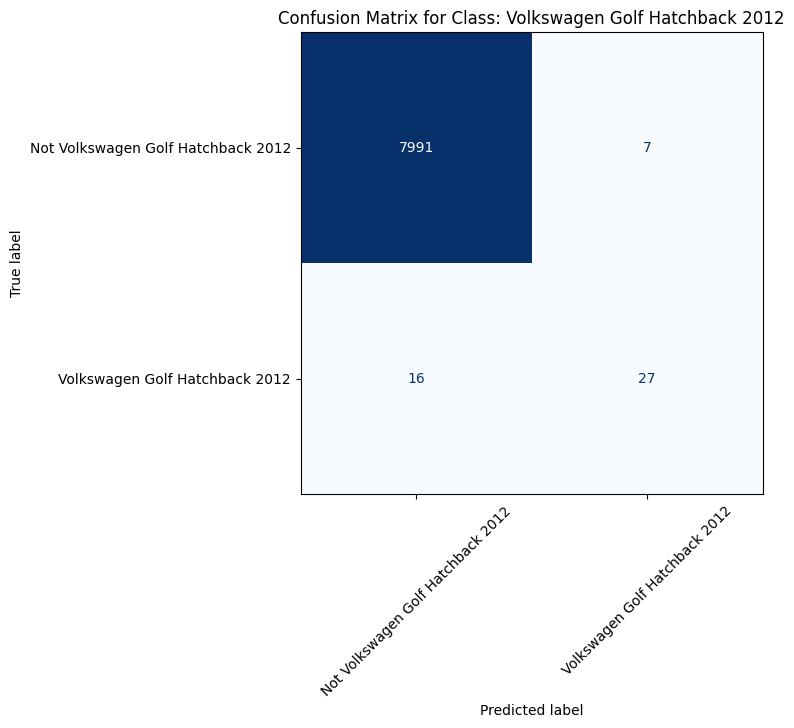

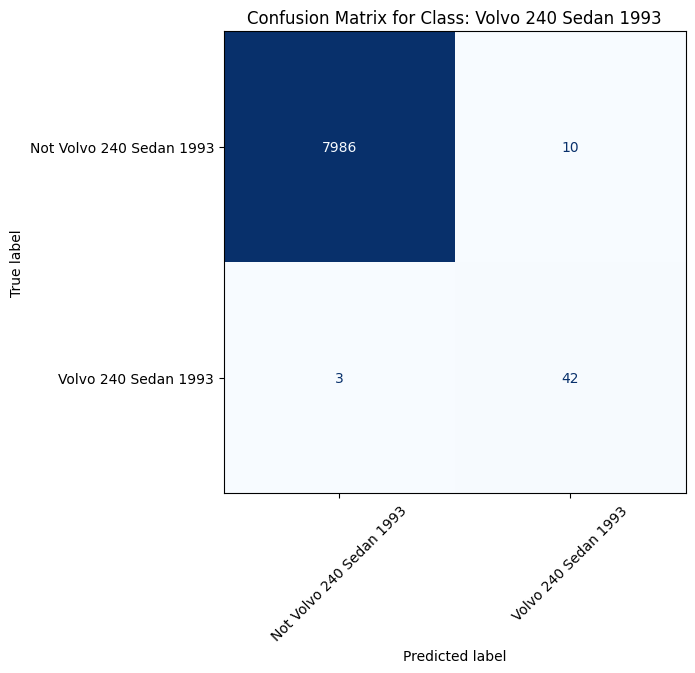

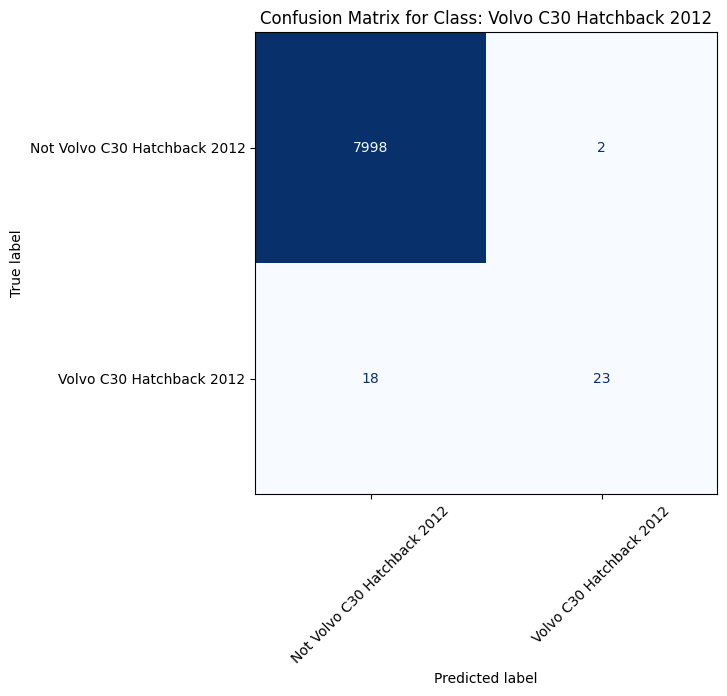

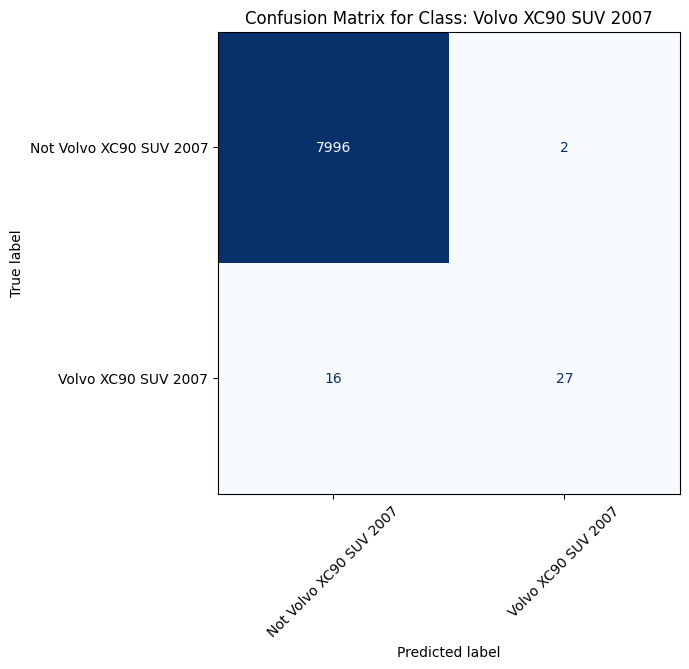

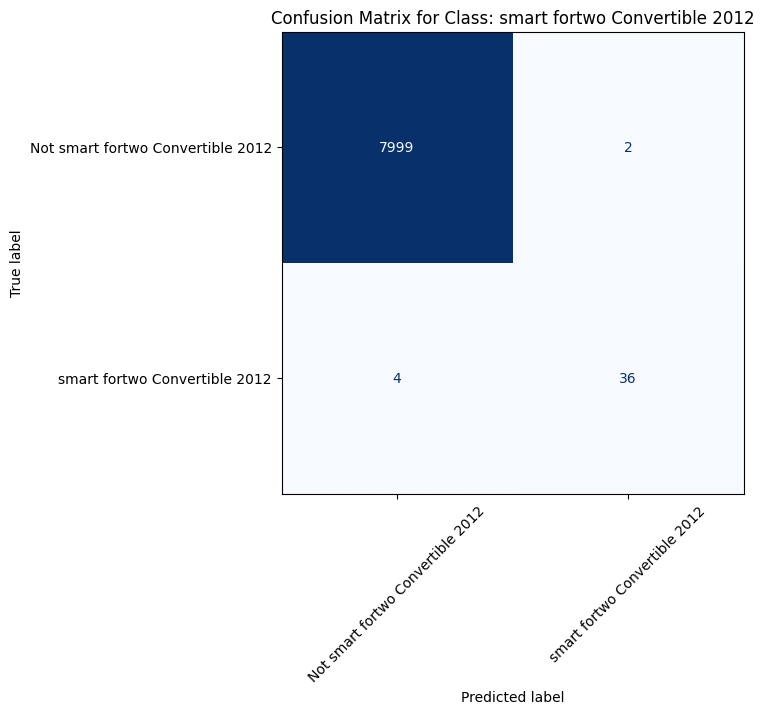

In [22]:
# Loop through each class and create a one-vs-all confusion matrix
for i, class_label in enumerate(class_labels):
    # Binary true and predicted labels for one-vs-all
    y_true_binary = (y_true_classes == i).astype(int)
    y_pred_binary = (y_pred == i).astype(int)

    # Compute confusion matrix
    cm_one_vs_all = confusion_matrix(y_true_binary, y_pred_binary)

    # Plot confusion matrix
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_one_vs_all, display_labels=["Not " + class_label, class_label])
    disp.plot(cmap='Blues', ax=ax, colorbar=False)

    plt.title(f"Confusion Matrix for Class: {class_label}")
    plt.xticks(rotation=45)
    plt.show()

## Classification Report --> Xception

In [23]:

print(classification_report(test_generator.classes, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.77      0.87        44
           1       0.87      0.77      0.82        44
           2       0.45      0.62      0.53        32
           3       0.63      0.84      0.72        43
           4       0.67      0.93      0.78        42
           5       0.67      0.80      0.73        40
           6       0.78      0.72      0.75        39
           7       0.47      0.62      0.54        45
           8       0.47      0.34      0.39        41
           9       0.59      0.39      0.47        33
          10       0.70      0.68      0.69        38
          11       0.65      0.70      0.67        40
          12       0.75      0.50      0.60        42
          13       0.50      0.93      0.65        41
          14       0.81      0.79      0.80        43
          15       0.75      0.67      0.71        36
          16       0.72      0.51      0.60        45
          17       0.48    

In [24]:
model_training_info = pd.DataFrame(history.history)
print(model_training_info)


    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.019949  5.063340      0.079609  4.388469         0.0001
1   0.115681  3.963940      0.255624  3.047970         0.0001
2   0.247732  3.047225      0.398919  2.339833         0.0001
3   0.373857  2.421425      0.485831  1.952081         0.0001
4   0.472300  1.965563      0.540608  1.681206         0.0001
5   0.548011  1.641457      0.582092  1.517493         0.0001
6   0.613892  1.382632      0.612767  1.423310         0.0001
7   0.661776  1.172954      0.642273  1.300080         0.0001
8   0.702902  1.031647      0.646509  1.289807         0.0001
9   0.740884  0.886436      0.673678  1.217614         0.0001
10  0.772650  0.778510      0.671779  1.201328         0.0001
11  0.792201  0.702380      0.673970  1.199888         0.0001
12  0.814101  0.620402      0.688577  1.176447         0.0001
13  0.832532  0.547326      0.704353  1.104520         0.0001
14  0.853963  0.489637      0.697634  1.133038         0.0001


## AUC & ROC --> Xception

ROC AUC Score (Micro): 0.9962


/tmp/ipykernel_23/635710288.py:41: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


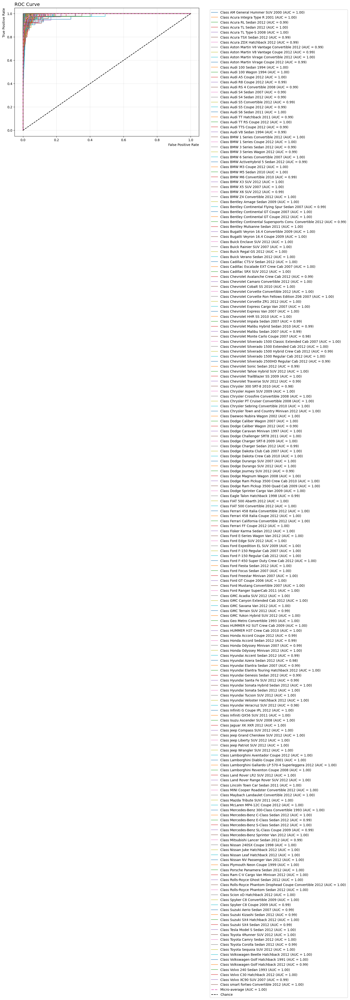

In [30]:
# Calculate ROC-AUC
# Convert y_true to one-hot encoding
y_true_one_hot = to_categorical(y_true_classes, num_classes=len(class_labels))

# Calculate the micro-average ROC AUC
roc_auc = roc_auc_score(y_true_one_hot, predictions, average="micro")
print(f"ROC AUC Score (Micro): {roc_auc:.4f}")

# Step 5: Plot ROC Curve
fpr = {}
tpr = {}
roc_auc_dict = {}

# Compute ROC for each class
for i in range(len(class_labels)):
    fpr[i], tpr[i], _ = roc_curve(y_true_one_hot[:, i], predictions[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_one_hot.ravel(), predictions.ravel())
roc_auc_dict["micro"] = auc(fpr["micro"], tpr["micro"])

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 7))

# Plot the ROC curve for each class
for i in range(len(class_labels)):
    ax.plot(fpr[i], tpr[i], label=f"Class {class_labels[i]} (AUC = {roc_auc_dict[i]:.2f})", alpha=0.7, linewidth=1.5)
# Plot micro-average ROC curve
ax.plot(fpr["micro"], tpr["micro"], label=f"Micro-average (AUC = {roc_auc_dict['micro']:.2f})", linestyle="--", linewidth=2)

# Plot random chance line
ax.plot([0, 1], [0, 1], "k--", label="Chance", linewidth=1.5)

# Set the labels, title, and legend
ax.set_xlabel("False Positive Rate", loc="right")  # Place X-axis label to the right
ax.set_ylabel("True Positive Rate", loc="top")    # Place Y-axis label on top
ax.set_title("ROC Curve",fontsize=14, loc="left")             # Align title to the left
ax.legend(bbox_to_anchor=(1.05, 1), loc="upper left", fontsize=10)
ax.grid(alpha=0.3)
plt.tight_layout()
plt.show()


## Saving Xception Model

In [32]:
Xception_model.save('my_xception_model.h5')

In [34]:

loaded_model = load_model('my_xception_model.h5')


252/252 ━━━━━━━━━━━━━━━━━━━━ 38s 151ms/step


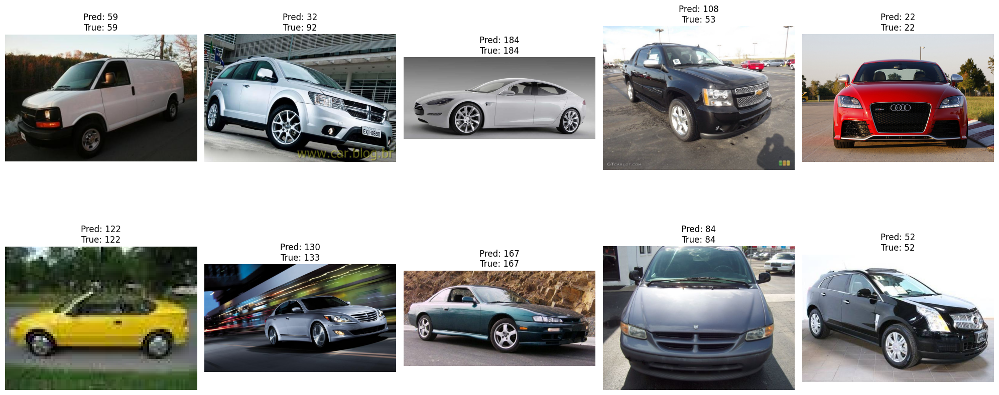

In [41]:
import random

random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = loaded_model.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  

fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path)
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    axes[row, col].set_title(f"Pred: {predicted_classes[idx]}\nTrue: {true_classes[idx]}")

plt.tight_layout()
plt.show()




252/252 ━━━━━━━━━━━━━━━━━━━━ 38s 153ms/step


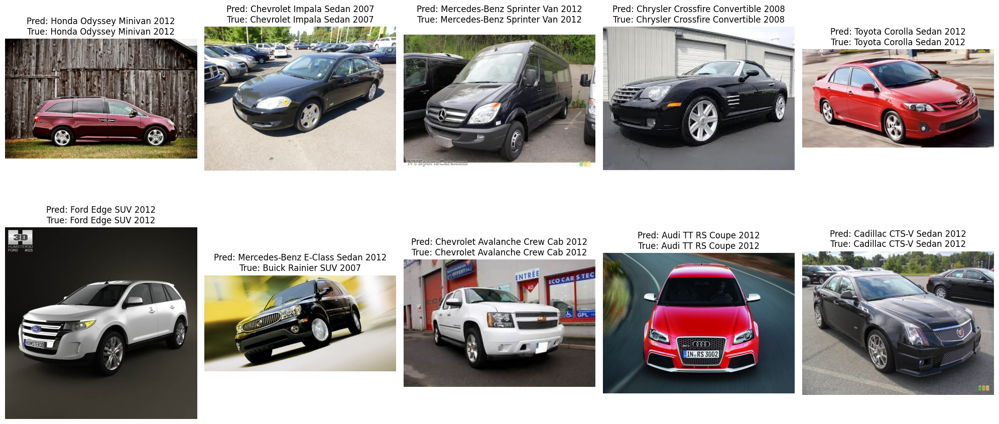

In [39]:
random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = loaded_model.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  


class_labels = list(test_generator.class_indices.keys())


fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path) 
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    
    predicted_label = class_labels[predicted_classes[idx]]
    true_label = class_labels[true_classes[idx]]
    axes[row, col].set_title(f"Pred: {predicted_label}\nTrue: {true_label}")

plt.tight_layout()
plt.show()

## DenseNet Model

In [46]:
from tensorflow.keras.layers import BatchNormalization

# Load the DenseNet model pre-trained with ImageNet
DenseNet_base_model = DenseNet121(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

# Freeze all layers except the last N layers for fine-tuning
for layer in DenseNet_base_model.layers[:-50]:  # Freeze all layers except the last 50
    layer.trainable = False

# Number of classes 
num_classes = 196

# Add custom layers to the DenseNet model
x = DenseNet_base_model.output
x = GlobalAveragePooling2D()(x)  # Apply global average pooling
x = Dense(1024, activation="relu")(x)  # Fully connected layer
x = BatchNormalization()(x)
x = Dropout(0.5)(x)  # Add dropout for regularization
x = Dense(512, activation="relu")(x)  # Another fully connected layer
x = Dropout(0.5)(x)  # Add dropout for regularization
predictions = Dense(num_classes, activation="softmax")(x)  # Output layer

# Create the final model with input and custom layers
DenseNet_model = Model(inputs=DenseNet_base_model.input, outputs=predictions)






## # Compile the DenseNet model

In [47]:
# Compile the DenseNet model
DenseNet_model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)


In [48]:
# Define callbacks for learning rate adjustment and early stopping
reduce_lr = ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.2,
    patience=3,
    min_lr=1e-6,
    verbose=1
)

early_stopping = EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True,
    verbose=1
)

callbacks = [reduce_lr, early_stopping]

## Train DenseNet Model

In [49]:
# Train the model with training and validation data
history_densenet = DenseNet_model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=20,
    callbacks=callbacks,
    verbose=1
)


Epoch 1/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 514s 548ms/step - accuracy: 0.0101 - loss: 6.2021 - val_accuracy: 0.1022 - val_loss: 4.4419 - learning_rate: 1.0000e-04
Epoch 2/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 440s 505ms/step - accuracy: 0.0561 - loss: 4.8666 - val_accuracy: 0.2007 - val_loss: 3.7241 - learning_rate: 1.0000e-04
Epoch 3/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 440s 505ms/step - accuracy: 0.1206 - loss: 4.1881 - val_accuracy: 0.2771 - val_loss: 3.2073 - learning_rate: 1.0000e-04
Epoch 4/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 437s 502ms/step - accuracy: 0.1905 - loss: 3.6116 - val_accuracy: 0.3544 - val_loss: 2.7751 - learning_rate: 1.0000e-04
Epoch 5/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 437s 502ms/step - accuracy: 0.2558 - loss: 3.1555 - val_accuracy: 0.4154 - val_loss: 2.4352 - learning_rate: 1.0000e-04
Epoch 6/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 440s 506ms/step - accuracy: 0.3187 - loss: 2.7727 - val_accuracy: 0.4518 - val_loss: 2.2256 - learning_rate: 1.0000e-04
Epoch 7/20
865/865 ━━━━━━━━━━━━━━━━━━━━ 

In [50]:

test_loss, test_accuracy = DenseNet_model.evaluate(test_generator)
print(f'Test Accuracy: {test_accuracy}')


252/252 ━━━━━━━━━━━━━━━━━━━━ 50s 198ms/step - accuracy: 0.6423 - loss: 1.2763
Test Accuracy: 0.6874766945838928


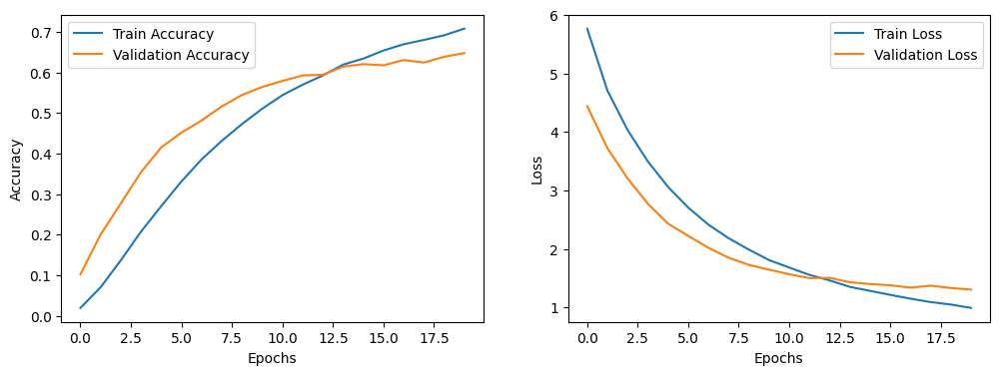

In [51]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history_densenet.history['accuracy'], label="Train Accuracy")
plt.plot(history_densenet.history['val_accuracy'], label="Validation Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history_densenet.history['loss'], label="Train Loss")
plt.plot(history_densenet.history['val_loss'], label="Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()

plt.show()


In [52]:
predictions = DenseNet_model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)


252/252 ━━━━━━━━━━━━━━━━━━━━ 48s 163ms/step


## Classification Report --> DenseNet

In [53]:

print(classification_report(test_generator.classes, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.89      0.94        44
           1       0.71      0.80      0.75        44
           2       0.53      0.28      0.37        32
           3       0.64      0.84      0.73        43
           4       0.88      0.69      0.77        42
           5       0.83      0.38      0.52        40
           6       0.61      0.56      0.59        39
           7       0.50      0.42      0.46        45
           8       0.54      0.32      0.40        41
           9       0.43      0.45      0.44        33
          10       0.74      0.76      0.75        38
          11       0.79      0.47      0.59        40
          12       0.67      0.48      0.56        42
          13       0.71      0.61      0.66        41
          14       0.75      0.77      0.76        43
          15       0.77      0.67      0.72        36
          16       0.53      0.36      0.43        45
          17       0.35    

In [54]:
model_training_info = pd.DataFrame(history_densenet.history)
print(model_training_info)


    accuracy      loss  val_accuracy  val_loss  learning_rate
0   0.019660  5.765101      0.102249  4.441898         0.0001
1   0.070435  4.708348      0.200701  3.724125         0.0001
2   0.137075  4.034319      0.277096  3.207315         0.0001
3   0.207799  3.497915      0.354368  2.775122         0.0001
4   0.270644  3.062832      0.415425  2.435182         0.0001
5   0.331502  2.709053      0.451797  2.225553         0.0001
6   0.386000  2.417113      0.481741  2.021426         0.0001
7   0.431643  2.184820      0.516506  1.852350         0.0001
8   0.473058  1.991030      0.544698  1.729354         0.0001
9   0.510824  1.811316      0.564417  1.648271         0.0001
10  0.544252  1.683785      0.579316  1.569520         0.0001
11  0.569947  1.558843      0.592755  1.503356         0.0001
12  0.592751  1.464153      0.594362  1.508493         0.0001
13  0.619457  1.354539      0.614519  1.432829         0.0001
14  0.634238  1.285551      0.620654  1.402982         0.0001
15  0.65

## Confusion Matrix --> DenseNet

In [56]:
y_trueclasses = test_generator.classes
# Compute confusion matrix
cmd = confusion_matrix(y_trueclasses, y_pred)
classlabels = list(test_generator.class_indices.keys())

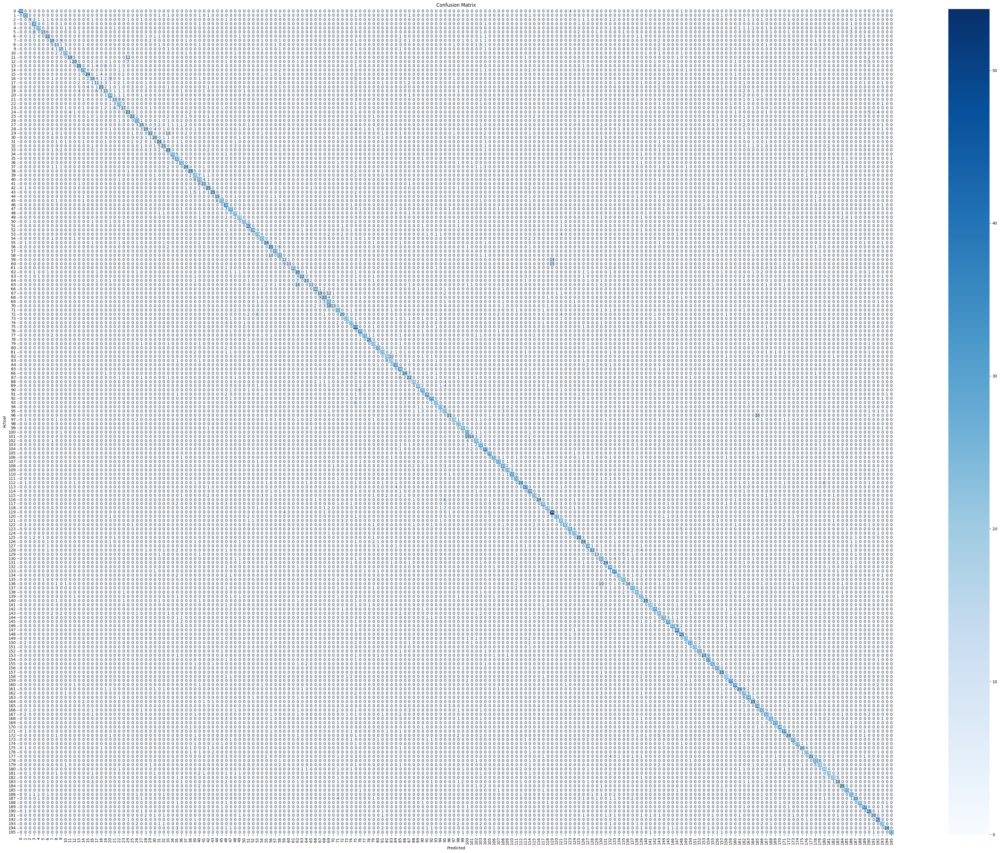

In [57]:
cmd = confusion_matrix(test_generator.classes, y_pred)
plt.figure(figsize=(50, 38))
sns.heatmap(cmd, annot=True, fmt='d', cmap='Blues')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.title('Confusion Matrix')
plt.show()


## confusion matrix for classes

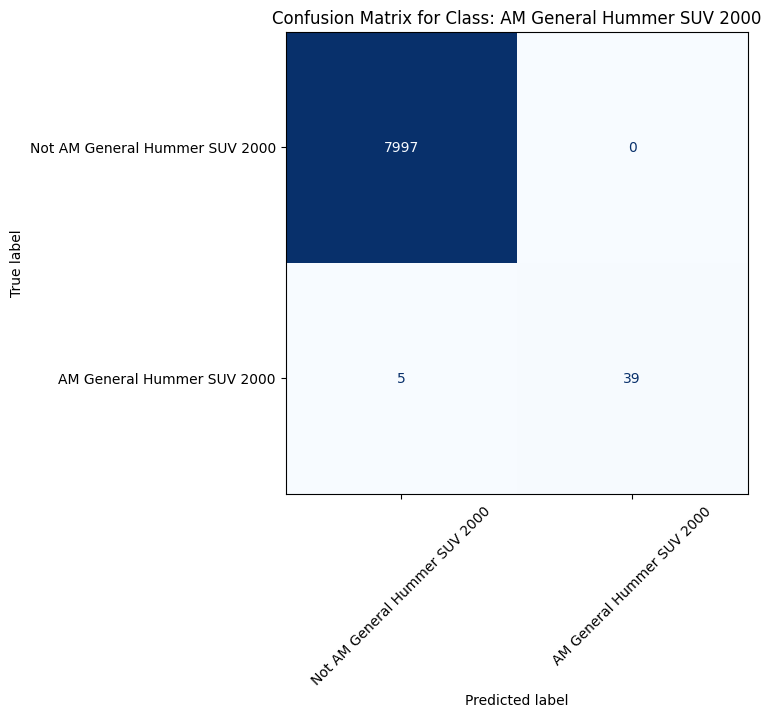

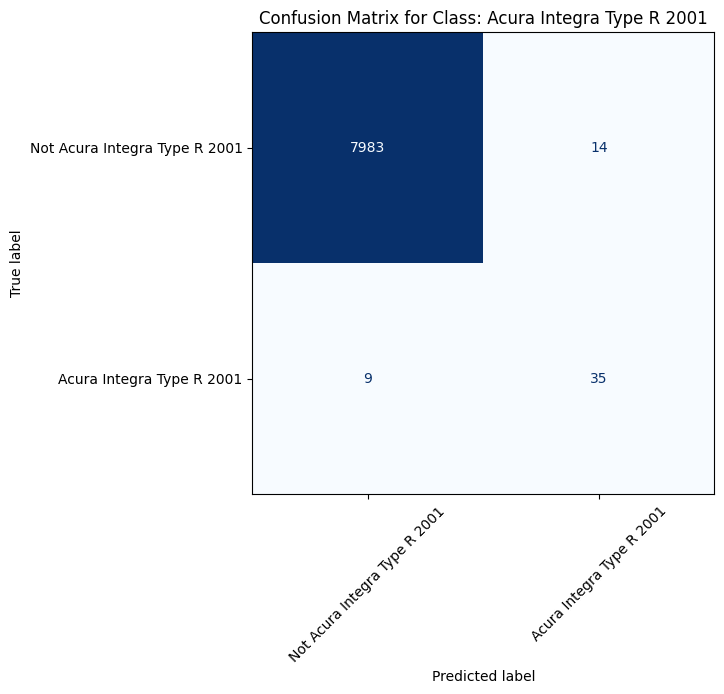

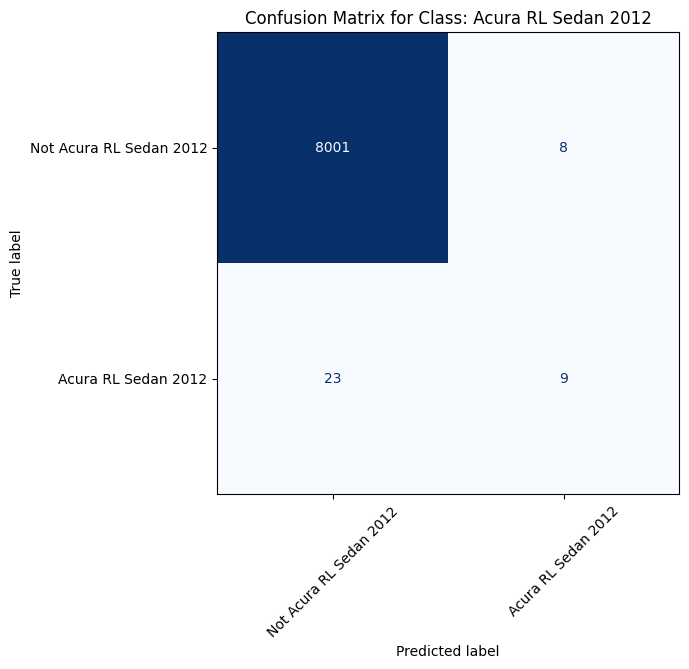

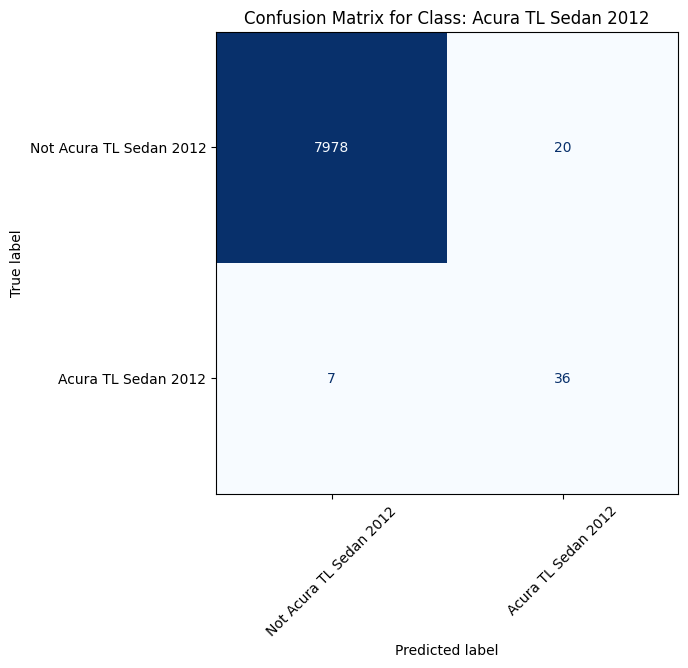

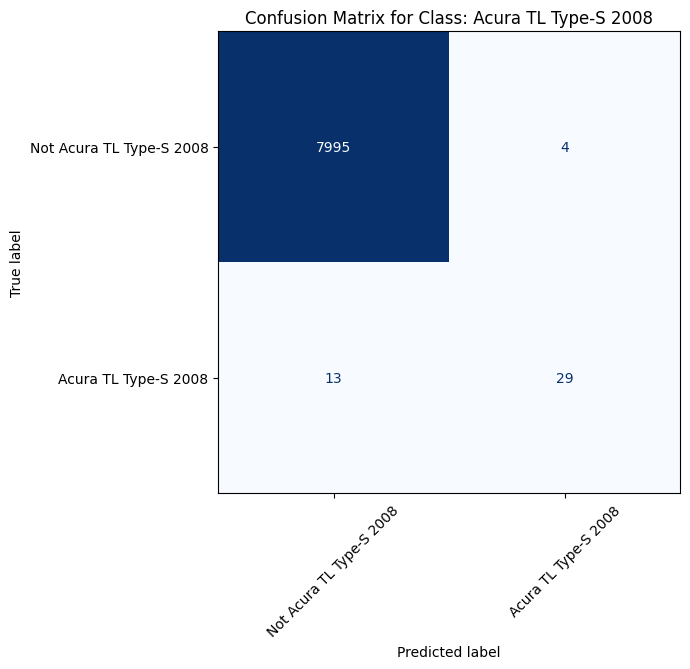

...

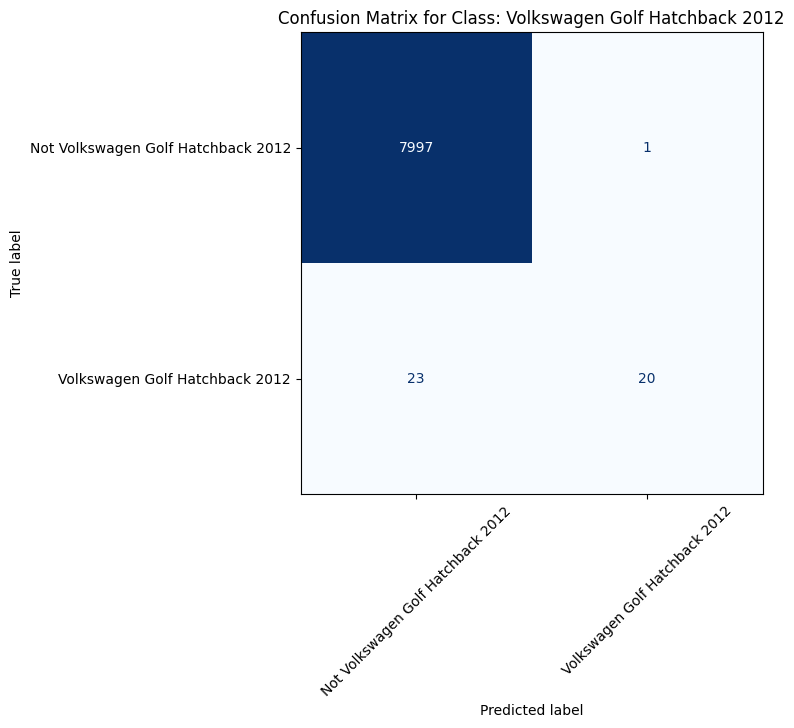

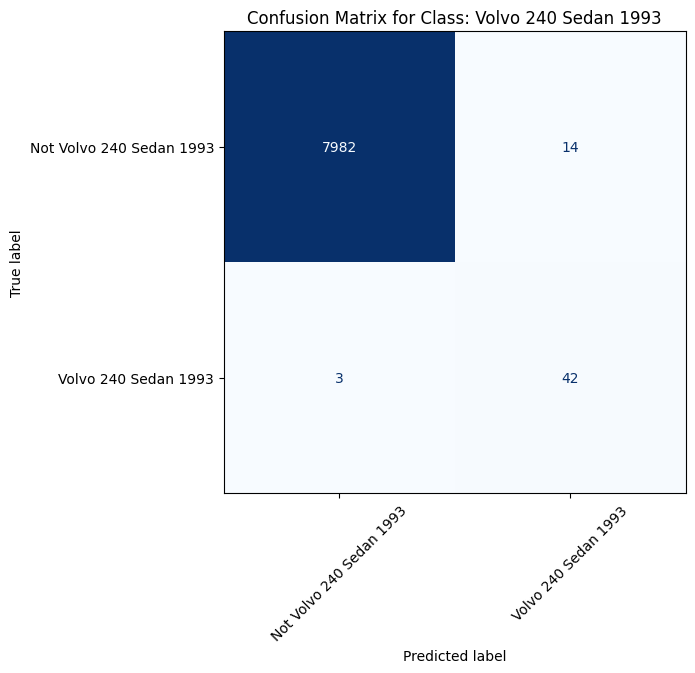

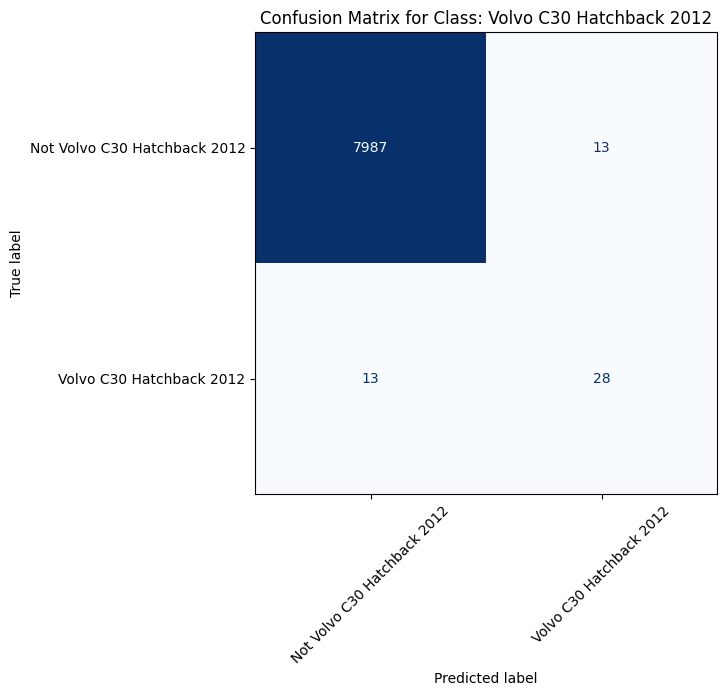

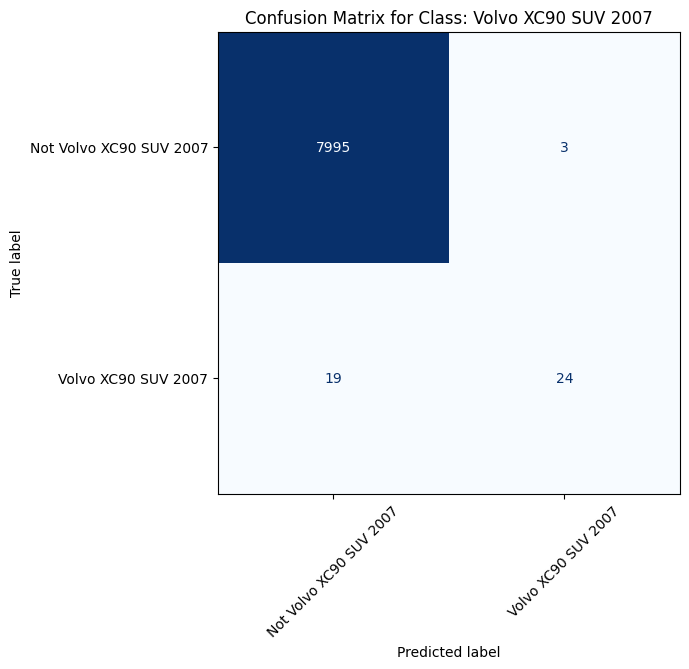

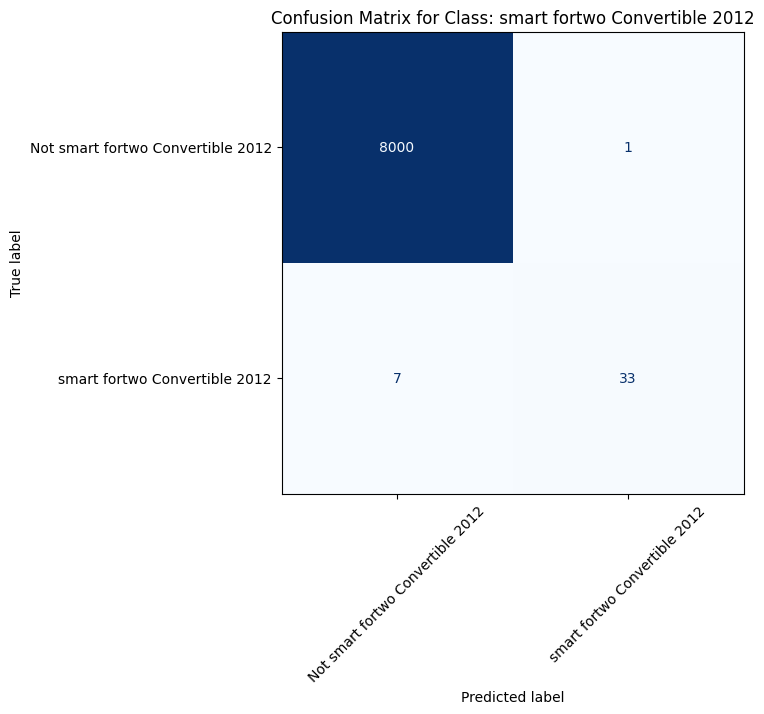

In [58]:
# Loop through each class and create a one-vs-all confusion matrix
for i, class_label in enumerate(classlabels):
    # Binary true and predicted labels for one-vs-all
    y_true_binary = (y_trueclasses == i).astype(int)
    y_pred_binary = (y_pred == i).astype(int)

    # Compute confusion matrix
    cm_one_vs_all = confusion_matrix(y_true_binary, y_pred_binary)

    # Plot confusion matrix
    fig, ax = plt.subplots(figsize=(6, 6))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_one_vs_all, display_labels=["Not " + class_label, class_label])
    disp.plot(cmap='Blues', ax=ax, colorbar=False)

    plt.title(f"Confusion Matrix for Class: {class_label}")
    plt.xticks(rotation=45)
    plt.show()

## AUC & ROC --> DenseNet

ROC AUC Score (Micro): 0.9950


/tmp/ipykernel_23/2504232194.py:41: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


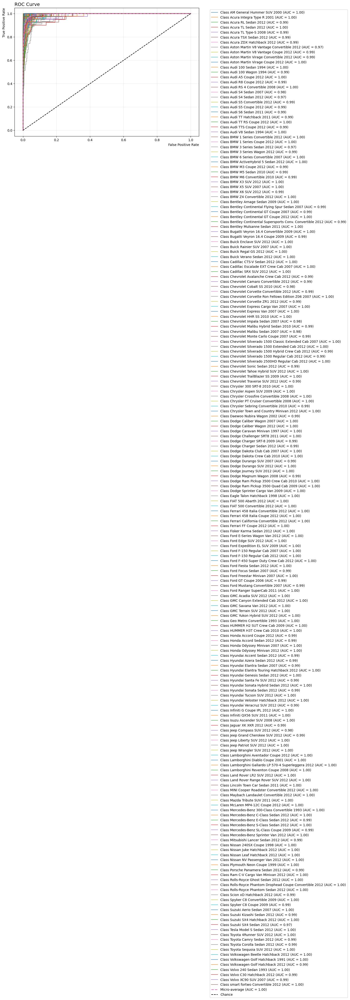

In [60]:
# Calculate ROC-AUC
# Convert y_true to one-hot encoding
y_true_one_hot = to_categorical(y_trueclasses, num_classes=len(classlabels))

# Calculate the micro-average ROC AUC
roc_auc = roc_auc_score(y_true_one_hot, predictions, average="micro")
print(f"ROC AUC Score (Micro): {roc_auc:.4f}")

# Step 5: Plot ROC Curve
fpr = {}
tpr = {}
roc_auc_dict = {}

# Compute ROC for each class
for i in range(len(classlabels)):
    fpr[i], tpr[i], _ = roc_curve(y_true_one_hot[:, i], predictions[:, i])
    roc_auc_dict[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_true_one_hot.ravel(), predictions.ravel())
roc_auc_dict["micro"] = auc(fpr["micro"], tpr["micro"])

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 7))

# Plot the ROC curve for each class
for i in range(len(classlabels)):
    ax.plot(fpr[i], tpr[i], label=f"Class {classlabels[i]} (AUC = {roc_auc_dict[i]:.2f})", alpha=0.7, linewidth=1.5)
# Plot micro-average ROC curve
ax.plot(fpr["micro"], tpr["micro"], label=f"Micro-average (AUC = {roc_auc_dict['micro']:.2f})", linestyle="--", linewidth=2)

# Plot random chance line
ax.plot([0, 1], [0, 1], "k--", label="Chance", linewidth=1.5)

# Set the labels, title, and legend
ax.set_xlabel("False Positive Rate", loc="right")  # Place X-axis label to the right
ax.set_ylabel("True Positive Rate", loc="top")    # Place Y-axis label on top
ax.set_title("ROC Curve",fontsize=14, loc="left")             # Align title to the left
ax.legend(bbox_to_anchor=(1.05, 1), loc="upper left", fontsize=10)
ax.grid(alpha=0.3)
plt.tight_layout()
plt.show()


## Saving DenseNet Model

In [61]:
DenseNet_model.save('my_densenet_model.h5')

In [63]:
model_den = load_model('my_densenet_model.h5')

252/252 ━━━━━━━━━━━━━━━━━━━━ 45s 158ms/step


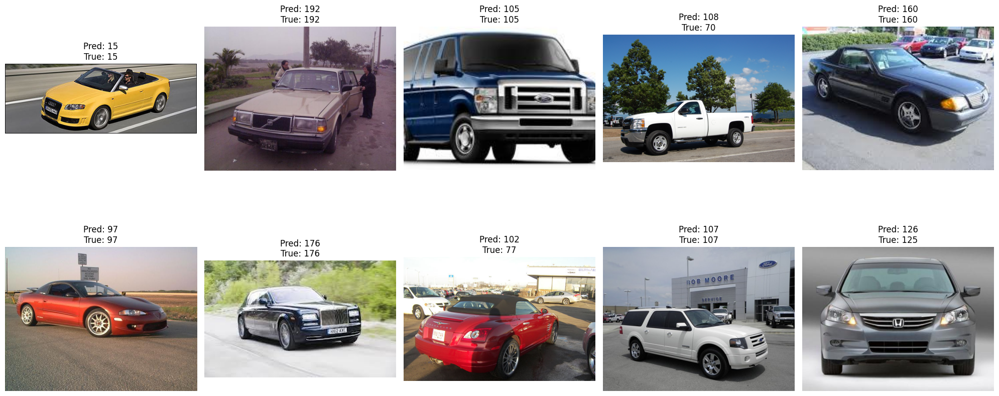

In [65]:
import random

random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = model_den.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  

fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path)
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    axes[row, col].set_title(f"Pred: {predicted_classes[idx]}\nTrue: {true_classes[idx]}")

plt.tight_layout()
plt.show()


252/252 ━━━━━━━━━━━━━━━━━━━━ 35s 137ms/step


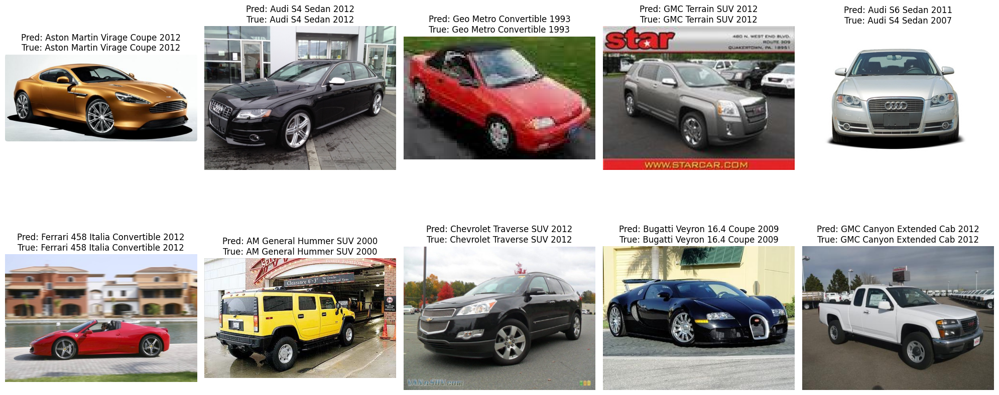

In [66]:
random_indices = random.sample(range(len(test_generator.filenames)), 10)

predictions = model_den.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1) 
true_classes = test_generator.classes  


class_labels = list(test_generator.class_indices.keys())


fig, axes = plt.subplots(2, 5, figsize=(20, 10))  

for i, idx in enumerate(random_indices):
    img_path = test_generator.filepaths[idx]  
    img = plt.imread(img_path) 
    
    row = i // 5
    col = i % 5
    axes[row, col].imshow(img)
    axes[row, col].axis('off')
    
    predicted_label = class_labels[predicted_classes[idx]]
    true_label = class_labels[true_classes[idx]]
    axes[row, col].set_title(f"Pred: {predicted_label}\nTrue: {true_label}")

plt.tight_layout()
plt.show()
